# Capstone Project: Saudi Stock Exchange Market (Tadawul)- PART 1
### Team Insight
#### <font color='#C70039'> Co-Authors: Amal Almutairi, Nouf Aljohani, Rahaf Alzahrani, Rawan Alsudias & Salha Nasser

Data Sources:

https://www.investing.com/stock-screener/?sp=country::52|sector::13|industry::a|equityType::a|exchange::28%3Ceq_market_cap;1

https://finance.yahoo.com/

**Notebook Contents**:

* [Installing Packages](##packages).
* [Calling Libraries](##import)
* [Load data from Github](##github)
* [Data Description](##datadescribe)
* [Load Data](##dataload1)
* [Preprocessing](##preprocessing) 
** Add Target Column.
** Data Cleaning.
** Feature Engineering (Adding Different Trading Factors Features)
*[Read Data from the previously saved CSV file](##readsavefiles)
* [Exploratory Data Analysis (Graphs and Insights)](##EDA)

## <a name = '#packages'>Installing Packages</a>

In [1]:
#surpass installation output
!pip install gwpy &> /dev/null

In [ ]:
!python -m pip uninstall matplotlib 
!pip install matplotlib==3.1.3 

 ### Installing fastai and ta for Feature Engineering and tsai (Time-series classification)

In [3]:
!pip install ta &> /dev/null
!pip3 install git+https://github.com/fastai/fastai.git &> /dev/null
stable = True # Set to True for latest pip version or False for main branch in GitHub
!pip install {"tsai -U" if stable else "git+https://github.com/timeseriesAI/tsai.git"} &> /dev/null


2. **ta** i.e. technical analysis library is used to for feature engineering, calculating various technical indicators.
>https://github.com/bukosabino/ta


In [ ]:
# for interactive charts
#!pip install chart-studio 

 ## <a name ='#import'>Importing Libariers</a>

In [3]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from datetime import datetime
import warnings
warnings.filterwarnings('ignore')

# Graphs
# Import the necessaries libraries
import plotly.graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
## to add new features 
from ta.momentum import RSIIndicator,StochasticOscillator

import plotly.offline as pyo
import plotly.graph_objs as go
# Set notebook mode to work in offline
pyo.init_notebook_mode()

from datetime import datetime
import plotly.express as px


#import chart_studio.plotly as py
#import chart_studio.tools as tls

## <a name="#github">Load Data from Github</a>


In [1]:
!git clone https://github.com/salohnana2018/Data-Science-Campus-Capstone-Project.git

Cloning into 'Data-Science-Campus-Capstone-Project'...


## <a name="#datadescribe">Data Description</a> 

**Date**: 10 years of data until 18-Aug-2022.

**Symbol**: Symbol of the company in the stock market.

**Price**: The closing price of the stock.

**Open**: The opening price of the stock.

**High**: Highest price of the stock at that day.

**Low**: Lowest price of the stock at that day.

**Vol.**: The total number of shares that have been bought or sold in the day.

**Change %**: percentage change of the stock between the current closing price and the closing price of the previous day.

**Sector**: The company's sector, in the dataset it is always Energy.

**Name**: Name of the company. 

**Industry**: Oil, Gas & Consumable Fuels  

**Simple Moving Average** - *A simple moving average (SMA) is an arithmetic moving average calculated by adding recent prices ( number of recent pr ices can be chose by parameter window) and then dividing that by the number of time periods in the calculation average.*


 **Exponential Moving Average** - *An exponential moving average (EMA) is a type of moving average (MA) that places a greater weight and significance on the most recent data points. It also takes window as a parameter.*


 **Relative Strength Index** - *The relative strength index (RSI) is a momentum indicator used in technical analysis that measures the magnitude of recent price changes to evaluate overbought or oversold conditions in the price of a stock or other asset.*
>[investopedia](https://www.investopedia.com/terms/r/rsi.asp)

 **MACD** - *Moving Average Convergence Divergence (MACD) is a trend-following momentum indicator that shows the relationship between two moving averages of a security’s price. The MACD is calculated by subtracting the 26-period Exponential Moving Average (EMA) from the 12-period EMA.*
>[investopedia](https://www.investopedia.com/terms/m/macd.asp)

 **Stochastic Oscillator** - *A stochastic oscillator is a momentum indicator comparing a particular closing price of a security to a range of its prices over a certain period of time. The sensitivity of the oscillator to market movements is reducible by adjusting that time period or by taking a moving average of the result. It is used to generate overbought and oversold trading signals, utilizing a 0-100 bounded range of values.*
>[investopedia](https://www.investopedia.com/terms/s/stochasticoscillator.asp#:~:text=A%20stochastic%20oscillator%20is%20a,moving%20average%20of%20the%20result).

## <a name="#dataload1">Load the data of each company</a>

In [4]:
df_2222 = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/2222_Historical_Data.csv')
df_2222.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,"Aug 18, 2022",2222,39.50,39.75,39.90,39.50,3.21M,-0.75%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
1,"Aug 17, 2022",2222,39.80,39.80,39.85,39.45,4.02M,0.00%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
2,"Aug 16, 2022",2222,39.80,40.35,40.35,39.80,5.33M,-1.61%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
3,"Aug 15, 2022",2222,40.45,40.40,40.45,39.85,5.04M,0.00%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
4,"Aug 14, 2022",2222,40.45,40.80,41.10,40.30,7.95M,-0.86%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"


In [7]:
df_2030 = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/2030_Historical_Data.csv')
df_2030.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,"Aug 18, 2022",2030,108.4,109.6,109.8,108.2,131.56K,-1.09%,Energy,SARCO,"Oil, Gas & Consumable Fuels"
1,"Aug 17, 2022",2030,109.6,110.6,110.6,109.2,181.43K,-0.90%,Energy,SARCO,"Oil, Gas & Consumable Fuels"
2,"Aug 16, 2022",2030,110.6,111.0,112.8,110.4,579.44K,-0.18%,Energy,SARCO,"Oil, Gas & Consumable Fuels"
3,"Aug 15, 2022",2030,110.8,108.2,111.8,108.2,551.55K,2.03%,Energy,SARCO,"Oil, Gas & Consumable Fuels"
4,"Aug 14, 2022",2030,108.6,109.2,110.6,108.0,284.74K,-1.27%,Energy,SARCO,"Oil, Gas & Consumable Fuels"


In [8]:
df_2380 = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/2380_Historical_Data.csv')
df_2380.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,"Aug 18, 2022",2380,18.36,18.50,18.56,18.36,6.08M,-0.33%,Energy,Petro Rabigh,"Oil, Gas & Consumable Fuels"
1,"Aug 17, 2022",2380,18.42,18.44,18.68,18.40,6.59M,0.33%,Energy,Petro Rabigh,"Oil, Gas & Consumable Fuels"
2,"Aug 16, 2022",2380,18.36,18.70,19.06,18.34,17.79M,-1.61%,Energy,Petro Rabigh,"Oil, Gas & Consumable Fuels"
3,"Aug 15, 2022",2380,18.66,18.00,18.66,17.80,21.48M,3.78%,Energy,Petro Rabigh,"Oil, Gas & Consumable Fuels"
4,"Aug 14, 2022",2380,17.98,19.48,19.58,17.92,36.87M,-3.95%,Energy,Petro Rabigh,"Oil, Gas & Consumable Fuels"


In [9]:
df_4030 = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/4030 Historical Data.csv')
df_4030.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,18-Aug-22,4030,28.25,28.05,28.50,28.00,2.12M,1.62%,Energy,Bahri,"Oil, Gas & Consumable Fuels"
1,17-Aug-22,4030,27.80,28.05,28.20,27.50,1.02M,-0.71%,Energy,Bahri,"Oil, Gas & Consumable Fuels"
2,16-Aug-22,4030,28.00,27.80,28.25,27.80,2.00M,1.08%,Energy,Bahri,"Oil, Gas & Consumable Fuels"
3,15-Aug-22,4030,27.70,27.65,27.90,27.10,1.53M,0.18%,Energy,Bahri,"Oil, Gas & Consumable Fuels"
4,14-Aug-22,4030,27.65,27.00,27.85,26.55,1.81M,2.22%,Energy,Bahri,"Oil, Gas & Consumable Fuels"


In [10]:
df_4200 = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/4200_Historical_Data.csv')
df_4200.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,"Aug 18, 2022",4200,71.2,72.5,72.7,71.2,222.53K,-1.39%,Energy,Aldrees,"Oil, Gas & Consumable Fuels"
1,"Aug 17, 2022",4200,72.2,71.6,72.7,71.5,434.74K,0.84%,Energy,Aldrees,"Oil, Gas & Consumable Fuels"
2,"Aug 16, 2022",4200,71.6,72.0,72.1,71.2,118.97K,0.00%,Energy,Aldrees,"Oil, Gas & Consumable Fuels"
3,"Aug 15, 2022",4200,71.6,71.2,72.0,70.6,177.04K,0.56%,Energy,Aldrees,"Oil, Gas & Consumable Fuels"
4,"Aug 14, 2022",4200,71.2,73.0,73.8,70.3,227.10K,-2.06%,Energy,Aldrees,"Oil, Gas & Consumable Fuels"


In [11]:
frames = [df_2222,df_2030,df_2380,df_4030,df_4200]

df_before_clean = pd.concat(frames,ignore_index=True)

In [12]:
df_before_clean.head()

,Date,Symbol,Price,Open,High,Low,Vol.,Change %,Sector,Name,Industry
0,"Aug 18, 2022",2222,39.50,39.75,39.90,39.50,3.21M,-0.75%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
1,"Aug 17, 2022",2222,39.80,39.80,39.85,39.45,4.02M,0.00%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
2,"Aug 16, 2022",2222,39.80,40.35,40.35,39.80,5.33M,-1.61%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
3,"Aug 15, 2022",2222,40.45,40.40,40.45,39.85,5.04M,0.00%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"
4,"Aug 14, 2022",2222,40.45,40.80,41.10,40.30,7.95M,-0.86%,Energy,Saudi Aramco,"Oil, Gas & Consumable Fuels"


## <a name="#preprocessing">Preprocessing</a>

In [13]:
# find the value that is missing and replace it using its actual value
df_before_clean[df_before_clean['Vol.'].isnull()==True]
df_before_clean.at[4993, 'Vol.'] = '24.16M'

In [14]:
# helper function
def featurecalculator(data):
  data['EMA_9'] = data['Close'].ewm(9).mean() # exponential moving average of window 9
  data['SMA_5'] = data['Close'].rolling(5).mean() # moving average of window 5
  data['SMA_10'] = data['Close'].rolling(10).mean() # moving average of window 10
  data['SMA_15'] = data['Close'].rolling(15).mean() # moving average of window 15
  data['SMA_20'] = data['Close'].rolling(20).mean() # moving average of window 20
  data['SMA_25'] = data['Close'].rolling(25).mean() # moving average of window 25
  data['SMA_30'] = data['Close'].rolling(30).mean() # moving average of window 30
  EMA_12 = pd.Series(data['Close'].ewm(span=12, min_periods=12).mean())
  EMA_26 = pd.Series(data['Close'].ewm(span=26, min_periods=26).mean())
  data['MACD'] = pd.Series(EMA_12 - EMA_26)    # calculates Moving Average Convergence Divergence
  data['RSI'] = RSIIndicator(data['Close']).rsi() # calculates Relative Strength Index 
  data['Stochastic']=StochasticOscillator(data['High'],data['Low'],data['Close']).stoch() # Calculates Stochastic Oscillator
  return data

def preproccessing_data(df): 
  df['Date']=pd.to_datetime(df['Date'])
  df.sort_values(by='Date', inplace=True)
  df.reset_index(drop=True)
  #Add Target Column
  df['Tomorrow']=df['Price'].shift(-1)
  df['Target']=(df['Tomorrow']> df['Price']).astype(int)
  # change the type and remove % from the data.
  df['Change %'] = df['Change %'].str.rstrip("%").astype(float)
  # remove the string (K & M) to be able to change the type, then change the data type to int. ==> easier to deal with it
  df["Vol."]=df["Vol."].replace({"K":"*1e3", "M":"*1e6"}, regex=True).map(pd.eval).astype(int)

  # change symbol type to stirng.
  df['Symbol']=df['Symbol'].astype(str)
  # renaming columns to suitable names.
  df.rename(columns={'Vol.':'Volume','Price':'Close'},inplace=True)
  # drop unnecessary columns.
  df = df.drop(['Sector','Industry'], axis=1)
  df = featurecalculator(df)
  # Dropping rows with Na values
  df=df.iloc[33:]
  df.reset_index(drop=True,inplace=True)
  df = df.fillna(method='ffill')
  # add new features
  df['Open-Close'] = df['Open'] - df['Close']
  df['High-Low'] = df.High - df.Low

  return df




In [15]:
df_after_clean = preproccessing_data(df_before_clean)

In [16]:
df_after_clean.isnull().sum() # check for missing values.

Date          0
Symbol        0
Close         0
Open          0
High          0
Low           0
Volume        0
Change %      0
Name          0
Tomorrow      0
Target        0
EMA_9         0
SMA_5         0
SMA_10        0
SMA_15        0
SMA_20        0
SMA_25        0
SMA_30        0
MACD          0
RSI           0
Stochastic    0
Open-Close    0
High-Low      0
dtype: int64

#### Save Cleaned Date to CSV and Excel.

In [ ]:
# df_after_clean.to_csv('/content/Data-Science-Campus-Capstone-Project/Data2/cleaned_data_frame.csv',index = False)
# df_after_clean.to_excel('/content/Data-Science-Campus-Capstone-Project/Data2/cleaned_data_frame.csv',index = False)

## <a name ='#readsavefiles'>Read Data from the previously saved CSV file</a>: 

In [18]:
# read data and parse Date
full_data_with_allFeatures = pd.read_csv('Data-Science-Campus-Capstone-Project/Data2/cleaned_data_frame.csv', parse_dates=['Date'])
# change Symbol to str.
full_data_with_allFeatures['Symbol']=full_data_with_allFeatures['Symbol'].astype(str)

In [19]:
df_Aramco=full_data_with_allFeatures[full_data_with_allFeatures['Name']=='Saudi Aramco']
df_SARCO=full_data_with_allFeatures[full_data_with_allFeatures['Name']=='SARCO']
df_Rabigh=full_data_with_allFeatures[full_data_with_allFeatures['Name']=='Petro Rabigh']
df_Bahri=full_data_with_allFeatures[full_data_with_allFeatures['Name']=='Bahri']
df_Aldrees=full_data_with_allFeatures[full_data_with_allFeatures['Name']=='Aldrees']

In [20]:
full_data_with_allFeatures.head()

,Date,Symbol,Close,Open,High,Low,Volume,Change %,Name,Tomorrow,...,SMA_10,SMA_15,SMA_20,SMA_25,SMA_30,MACD,RSI,Stochastic,Open-Close,High-Low
0,2012-09-04,2030,64.75,64.00,65.50,63.00,465750,0.78,SARCO,13.73,...,31.987,30.462667,32.9105,31.7808,30.919333,2.031657,54.878397,92.748368,-0.75,2.50
1,2012-09-04,2380,13.73,13.69,13.76,13.59,735270,0.00,Petro Rabigh,27.00,...,31.998,30.448667,32.2060,31.7380,30.938000,0.327165,47.682890,0.253807,-0.04,0.17
2,2012-09-04,4200,27.00,27.38,27.38,26.85,353740,-1.10,Aldrees,67.50,...,33.234,31.264667,30.3060,30.1780,29.696333,-0.011982,49.536229,25.344925,0.38,0.53
3,2012-09-05,2030,67.50,64.50,68.00,64.25,1410000,4.25,SARCO,27.00,...,37.209,31.314667,32.2860,31.8100,31.066333,2.781835,54.799146,99.081051,-3.00,3.75
4,2012-09-05,4200,27.00,27.07,27.15,26.77,273880,0.00,Aldrees,13.59,...,33.434,32.194667,32.8960,32.2980,31.470333,1.864536,49.265923,24.646205,0.07,0.38


In [21]:
full_data_with_allFeatures.info() # check all dtypes are correct.

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10596 entries, 0 to 10595
Data columns (total 23 columns):
 #   Column      Non-Null Count  Dtype         
---  ------      --------------  -----         
 0   Date        10596 non-null  datetime64[ns]
 1   Symbol      10596 non-null  object        
 2   Close       10596 non-null  float64       
 3   Open        10596 non-null  float64       
 4   High        10596 non-null  float64       
 5   Low         10596 non-null  float64       
 6   Volume      10596 non-null  int64         
 7   Change %    10596 non-null  float64       
 8   Name        10596 non-null  object        
 9   Tomorrow    10596 non-null  float64       
 10  Target      10596 non-null  int64         
 11  EMA_9       10596 non-null  float64       
 12  SMA_5       10596 non-null  float64       
 13  SMA_10      10596 non-null  float64       
 14  SMA_15      10596 non-null  float64       
 15  SMA_20      10596 non-null  float64       
 16  SMA_25      10596 non-

## <a name='#EDA'>Exploratory Data Analysis (EDA)</a>

### 1. Prices Relationship (OHLC) 

####  This graph visually represent the relationships between Open, Close, High, and Low features; as we see, it is almost a perfect positive linear relationship, which is expected since the differences between these values on the same day are usually small.

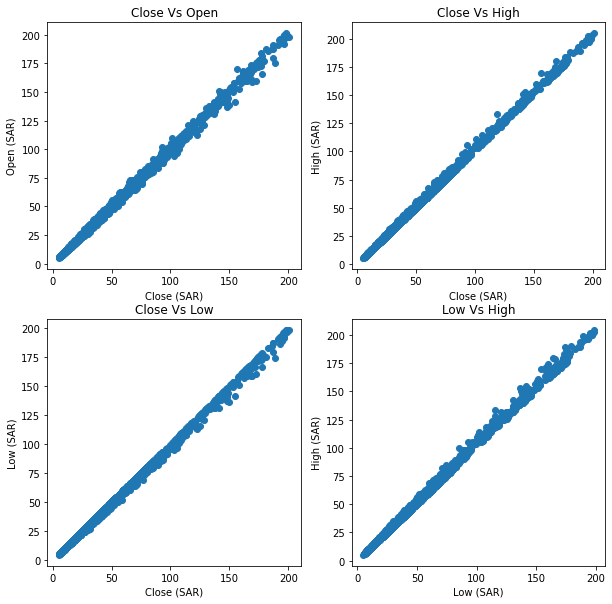

In [22]:
plt.figure(figsize=(10, 10))
plt.subplot(2, 2, 1)
plt.scatter(x='Close',y='Open',data=full_data_with_allFeatures)
plt.xlabel('Close (SAR)')
plt.ylabel('Open (SAR)')
plt.title('Close Vs Open')
plt.subplot(2, 2, 2)
plt.scatter(x='Close',y='High',data=full_data_with_allFeatures)
plt.xlabel('Close (SAR)')
plt.ylabel('High (SAR)')
plt.title('Close Vs High')
plt.subplot(2, 2, 3)
plt.scatter(x='Close',y='Low',data=full_data_with_allFeatures)
plt.xlabel('Close (SAR)')
plt.ylabel('Low (SAR)')
plt.title('Close Vs Low')
plt.subplot(2, 2, 4)
plt.scatter(x='Low',y='High',data=full_data_with_allFeatures)
plt.xlabel('Low (SAR)')
plt.ylabel('High (SAR)')
plt.title('Low Vs High')

plt.show()

### 2. Heatmaps

This section shows the correlation heatmaps for all companies in the Energy sector in Saudi Arabia between all the features in the dataset. This graph is essential in establishing the most relevant components in deciding the outcome of the close price going up or down. The clearest example in the first graph of Saudi Aramco company would be MACD which has a correlation value of -0.28, and this feature, combined with other features, can create a good prediction model. The same graph was created with the rest of the companies, and the correlation values were similar to the shown graph. 

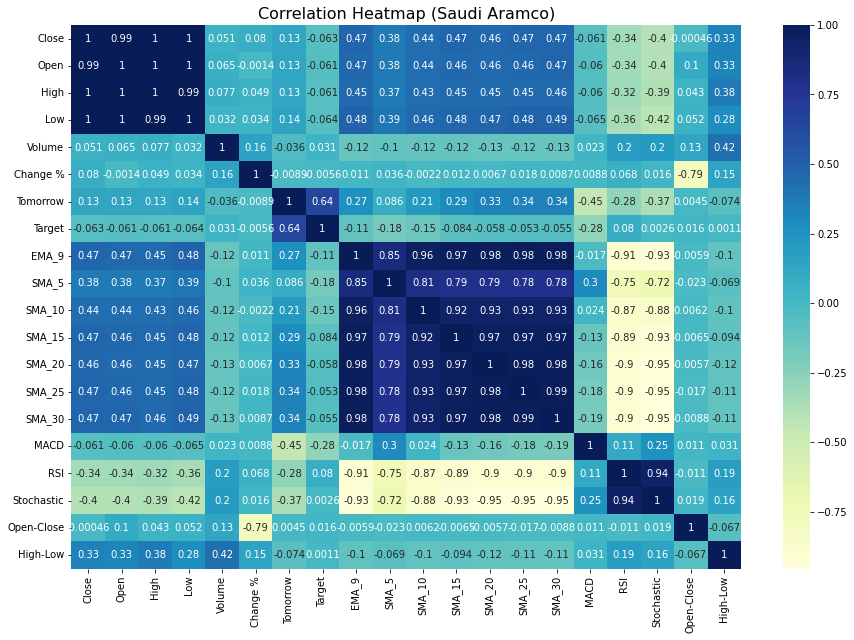

In [23]:
plt.figure(figsize=(15,10))
# Add title
plt.title("Correlation Heatmap (Saudi Aramco)", size=16)
sns.heatmap(df_Aramco.corr(), annot=True, cmap="YlGnBu")
#plt.savefig("corr_heatmap.png", format="png", dpi=1200)
plt.show()

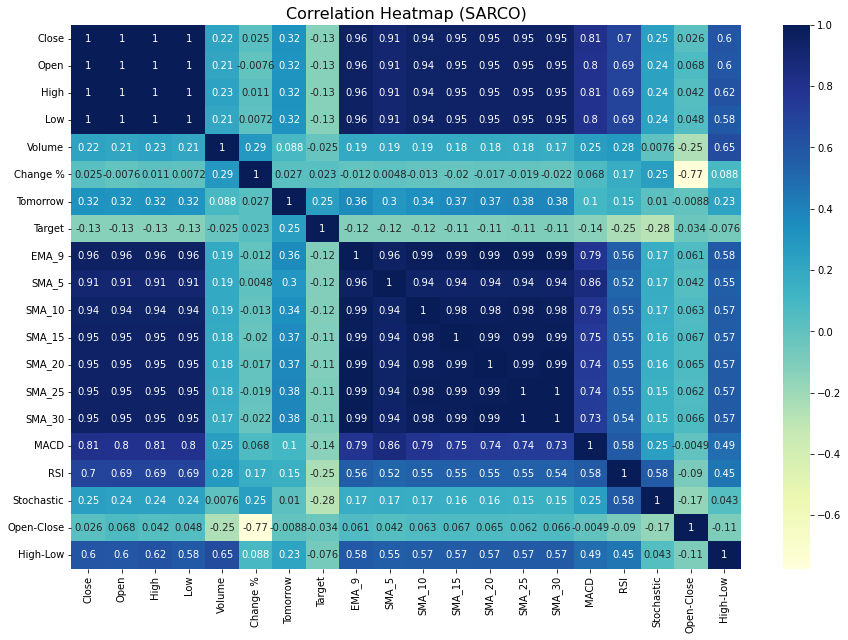

In [24]:
corr=df_SARCO.corr()# Set the width and height of the figure
plt.figure(figsize=(15,10))
# Add title
plt.title("Correlation Heatmap (SARCO)", size=16)
sns.heatmap(df_SARCO.corr(), annot=True, cmap="YlGnBu")
#plt.savefig("corr_heatmap.png", format="png", dpi=1200)
plt.show()

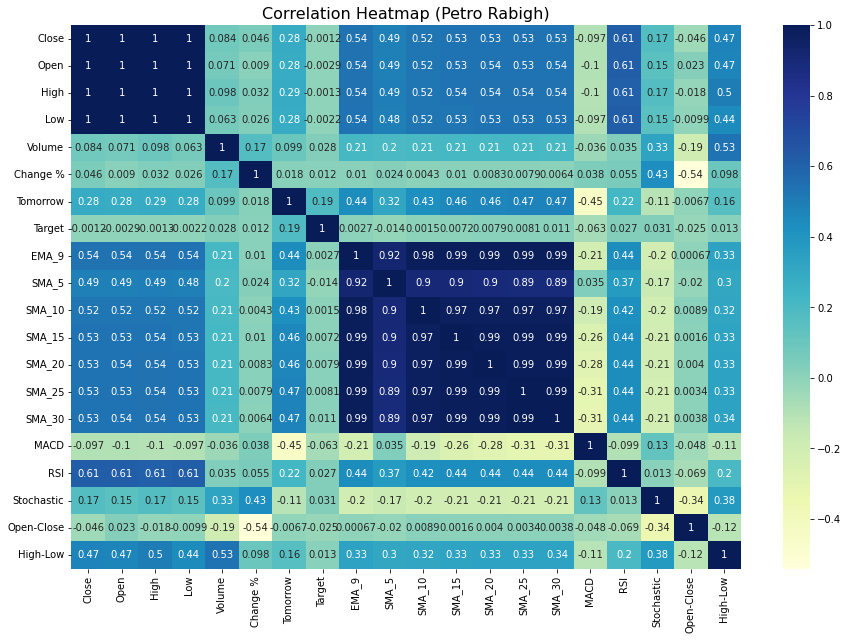

In [25]:
corr=df_Rabigh.corr()# Set the width and height of the figure
plt.figure(figsize=(15,10))
# Add title
plt.title("Correlation Heatmap (Petro Rabigh)", size=16)
sns.heatmap(df_Rabigh.corr(), annot=True, cmap="YlGnBu")
#plt.savefig("corr_heatmap.png", format="png", dpi=1200)
plt.show()

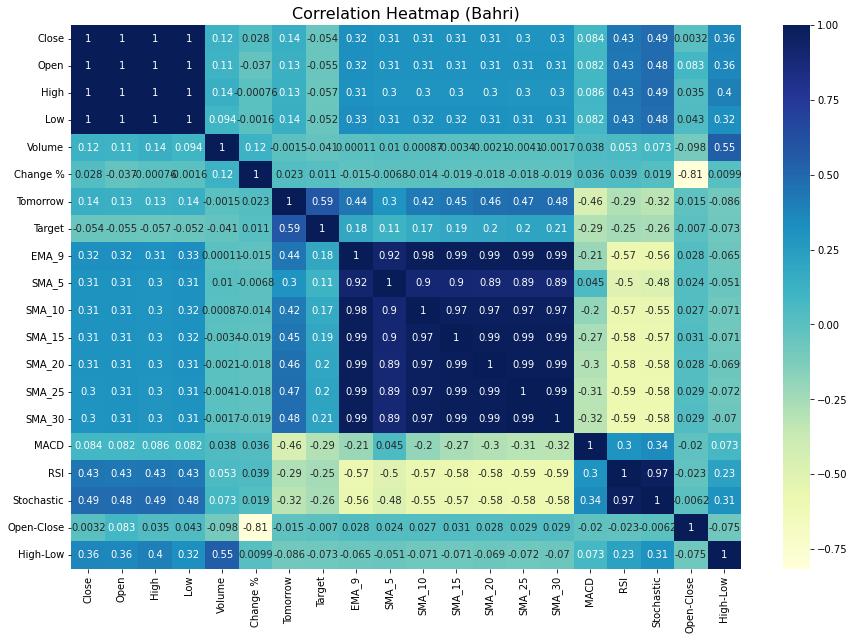

In [26]:
corr=df_Bahri.corr()# Set the width and height of the figure
plt.figure(figsize=(15,10))
# Add title
plt.title("Correlation Heatmap (Bahri)", size=16)
sns.heatmap(df_Bahri.corr(), annot=True, cmap="YlGnBu")
#plt.savefig("corr_heatmap.png", format="png", dpi=1200)
plt.show()

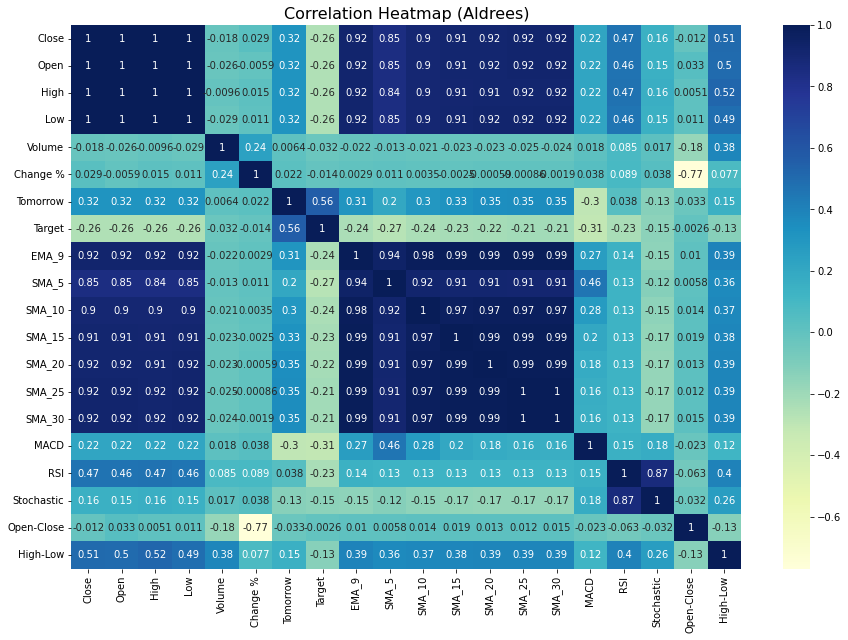

In [27]:
corr=df_Aldrees.corr()# Set the width and height of the figure
plt.figure(figsize=(15,10))
# Add title
plt.title("Correlation Heatmap (Aldrees)", size=16)
sns.heatmap(df_Aldrees.corr(), annot=True, cmap="YlGnBu")
#plt.savefig("corr_heatmap.png", format="png", dpi=1200)
plt.show()

### 3. Pairplot

This graph shows a pair plot of the stock dataset against the target feature (Target), which is 1 if the closing price is higher than today or 0 if the price goes down. So, we can see which features are the most important in deciding whether a the stock closing price is more likely to go high or down. 

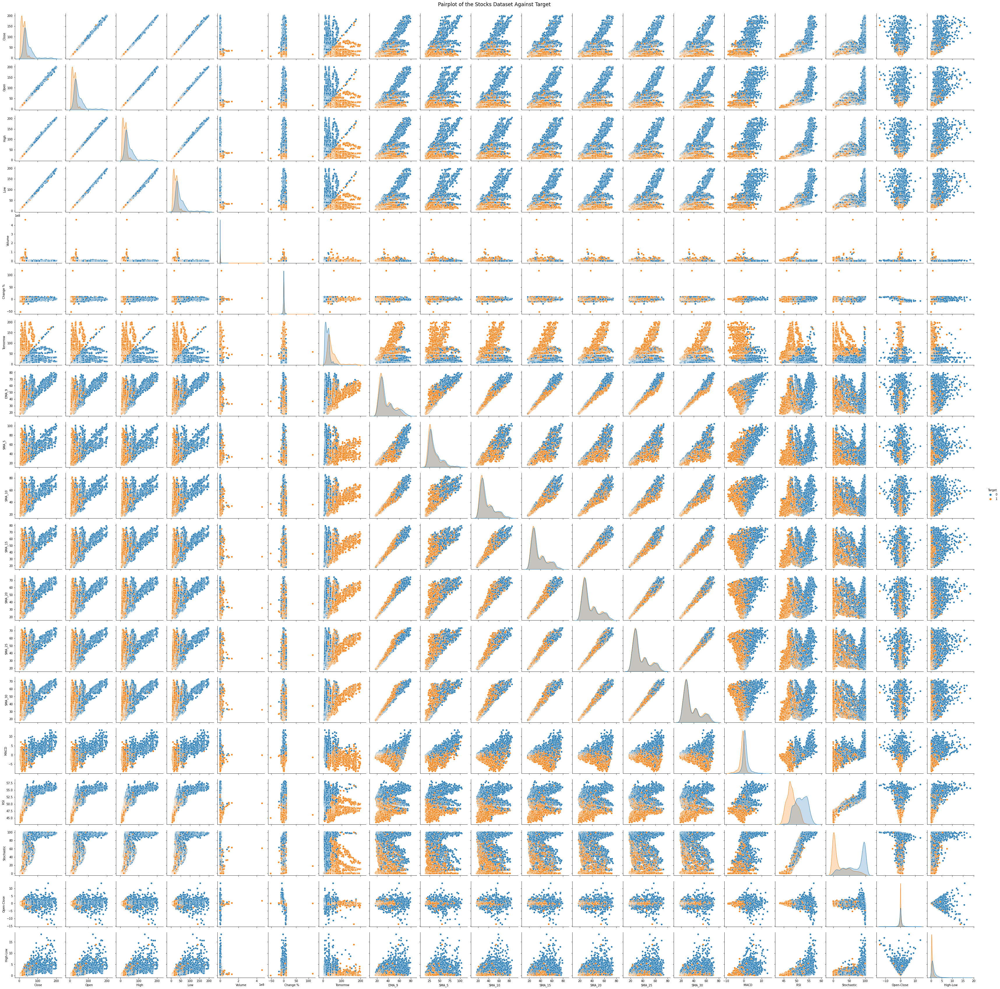

In [28]:
pp = sns.pairplot(full_data_with_allFeatures, hue='Target')
pp.fig.suptitle("Pairplot of the Stocks Dataset Against Target ",  y=1, size='xx-large')
plt.show()


### 4. Candelstick.  

A candlestick is a favored graph consisting of the stock's OHLC values (Open - High - Low - Close) to show its possible direction based on historical data. This graph shows one month, six months, one year, three years, or all the available data in the dataset, which in our case is ten years for all the companies except for Aramco.
We can see that Aramco's stock reached its highest price point of 42.5 SAR on May 16th this year (2022), while SARCO reached its highest price point of 204.6 SAR on Apr 7th, 2021 


In [29]:
# Aramco
fig = go.Figure(data=[go.Candlestick(x=df_Aramco['Date'],
                open=df_Aramco['Open'],
                high=df_Aramco['High'],
                low=df_Aramco['Low'],
                close=df_Aramco['Close'])])
fig.update_layout(title={'text':'Saudi Aramco', 'x':0.5}, yaxis_title='Price (SAR)', xaxis_title='Date')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="3y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
#py.plot(fig, filename="candelstrick_Aramco", auto_open = True)


In [30]:
# SARCO
fig = go.Figure(data=[go.Candlestick(x=df_SARCO['Date'],
                open=df_SARCO['Open'],
                high=df_SARCO['High'],
                low=df_SARCO['Low'],
                close=df_SARCO['Close'])])
fig.update_layout(title={'text':'SARCO', 'x':0.5}, yaxis_title='Price (SAR)', xaxis_title='Date')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
#py.plot(fig, filename="candelstrick_SARCO", auto_open = True)

In [31]:
# Petro Rabigh
fig = go.Figure(data=[go.Candlestick(x=df_Rabigh['Date'],
                open=df_Rabigh['Open'],
                high=df_Rabigh['High'],
                low=df_Rabigh['Low'],
                close=df_Rabigh['Close'])])
fig.update_layout(title={'text':'Petro Rabigh', 'x':0.5}, yaxis_title='Price (SAR)', xaxis_title='Date')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
#py.plot(fig, filename="candelstrick_Rabigh", auto_open = True)

In [33]:
# Bahri
fig = go.Figure(data=[go.Candlestick(x=df_Bahri['Date'],
                open=df_Bahri['Open'],
                high=df_Bahri['High'],
                low=df_Bahri['Low'],
                close=df_Bahri['Close'])])
fig.update_layout(title={'text':'Bahri', 'x':0.5}, yaxis_title='Price (SAR)', xaxis_title='Date')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
#py.plot(fig, filename="candelstrick_Bahri", auto_open = True)

In [32]:
# Bahri
fig = go.Figure(data=[go.Candlestick(x=df_Aldrees['Date'],
                open=df_Aldrees['Open'],
                high=df_Aldrees['High'],
                low=df_Aldrees['Low'],
                close=df_Aldrees['Close'], 
                name='Price')])
fig.update_layout(title={'text':'Aldrees', 'x':0.5},yaxis_title='Price (SAR)', xaxis_title='Date')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()
#py.plot(fig, filename="candelstrick_Aldrees", auto_open = True)

### 5. Volume

Insight
---
The volume indicates how many shares are bought and sold over a given period. As can be seen, Aramco has its highest activity when it is open. Another observation is that the volume drop in all companies in 2020 shows the effect of the COVID-19 lockdown on the stock market.  


In [35]:
########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1, 1,1,1,1])
            

fig.add_trace(go.Bar(x=df_Aramco['Date'],
                        y=df_Aramco['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Aramco'),
                row=1,
                col=1)

fig.update_xaxes(title_text='Date', row=1, col=1);
fig.update_yaxes(title_text='Aramco', row=1, col=1);
fig.update_xaxes(
    rangeslider_visible=False,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    ),row=1, col=1
);


fig.add_trace(go.Bar(x=df_SARCO['Date'],
                        y=df_SARCO['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='SARCO'),
                row=2,
                col=1)

fig.update_xaxes(title_text='Date', row=2, col=1);
fig.update_yaxes(title_text='SARCO', row=2, col=1);



#------------

fig.add_trace(go.Bar(x=df_Rabigh['Date'],
                        y=df_Rabigh['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Rabigh'),
                row=3,
                col=1)

fig.update_xaxes(title_text='Date', row=3, col=1);
fig.update_yaxes(title_text='Rabigh', row=3, col=1);


#-------------

fig.add_trace(go.Bar(x=df_Bahri['Date'],
                        y=df_Bahri['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Bahri'),
                row=4,
                col=1)

fig.update_xaxes(title_text='Date', row=4, col=1);
fig.update_yaxes(title_text='Bahri', row=4, col=1);
#---------------------------

fig.add_trace(go.Bar(x=df_Aldrees['Date'],
                        y=df_Aldrees['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Aldrees'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Aldrees', row=5, col=1);

# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=620,
                  height=620,
                  plot_bgcolor='white',
                  paper_bgcolor='white',
                  title={
                      'text': '{}'.format('Stock Volume of Energy Sector Companies in Saudi Arabia'),
                      'y': 0.99
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.05,
                              yanchor='bottom',
                              y=1.003))

# ---------------------- Volum graphs 





# Customize axis parameters
axis_lw, axis_color = 2, 'black'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))


fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))



fig.show()
#py.plot(fig, filename="AllCompaniesVolume", auto_open = True)


### 6. Averge Monthly Closing Price for Each Company. 

This graph shows the average monthly closing price for the enery sector companines in Saudi Arabia, and it helps in showing any tends in the prices along the different months of the year.  

In [36]:
fig = px.histogram(df_Aramco, x="Date", y="Close", histfunc="avg", title="Aramco's Average Monthly Closing Price")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1, yaxis_title='Average Closing Price (SAR)')
fig.add_trace(go.Scatter(mode="markers", x=df_Aramco["Date"], y=df_Aramco["Close"], name="daily"))
fig.show()

In [37]:
fig = px.histogram(df_SARCO, x="Date", y="Close", histfunc="avg", title="SARCO's Average Monthly Closing Price")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1, yaxis_title='Average Closing Price (SAR)')
fig.add_trace(go.Scatter(mode="markers", x=df_SARCO["Date"], y=df_SARCO["Close"], name="daily"))
fig.show()

In [38]:
fig = px.histogram(df_Rabigh, x="Date", y="Close", histfunc="avg", title="Rabigh's Average Monthly Closing Price")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1, yaxis_title='Average Closing Price (SAR)')
fig.add_trace(go.Scatter(mode="markers", x=df_Rabigh["Date"], y=df_Rabigh["Close"], name="daily"))
fig.show()

In [39]:
fig = px.histogram(df_Bahri, x="Date", y="Close", histfunc="avg", title="Bahri's Average Monthly Closing Price")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1, yaxis_title='Average Closing Price (SAR)')
fig.add_trace(go.Scatter(mode="markers", x=df_Bahri["Date"], y=df_Bahri["Close"], name="daily"))
fig.show()

In [40]:
fig = px.histogram(df_Aldrees, x="Date", y="Close", histfunc="avg", title="Aldrees's Average Monthly Closing Price")
fig.update_traces(xbins_size="M1")
fig.update_xaxes(showgrid=True, ticklabelmode="period", dtick="M1", tickformat="%b\n%Y")
fig.update_layout(bargap=0.1, yaxis_title='Average Closing Price (SAR)')
fig.add_trace(go.Scatter(mode="markers", x=df_Aldrees["Date"], y=df_Aldrees["Close"], name="daily"))
fig.show()

### 7. Closing Price for Energy Sector.

This graph shows the closing price of Energy Sector companies in Saudi Arabia, and we can see prices of all companies dropped significantly starting from the fourth quarter of 2015 and began recovering in mid-2018. One company that recovered well and had a sharp jump in prices is SARCO starting in Aug 2020, reaching its highest price point of 201 SAR in Apr 2021. The rest of the companies recovered but did not match their highest point after 2016. Also, we can see Saudi Aramco has had somewhat consistent prices since going public in Dec 2019, except for a high drop in Mar 2020.

Insight
---
As can be seen, there was a drop in closing prices in 2016 and 2020. The price drops in 2016  may be returned to a growing supply glut that failed to boost global growth, increasing U.S. shale oil production and geopolitical concerns. While in 2020, it can be related to the decreasing oil demand due to the COVID-19 lockdown. Also, the prices have been slight since February 2022, which can be reflected due to the Russian-Ukrainian war.

In [41]:
df_prices= full_data_with_allFeatures.loc[:, ['Name', 'Date', 'Close']]
df_prices.rename(columns={'Name': 'Company'}, inplace=True)
df_prices_pair= pd.pivot(df_prices, index='Date', columns='Company', values='Close')


In [42]:
df_prices_month= full_data_with_allFeatures.loc[:, ['Name', 'Date', 'Close']]
#df_prices.set_index('Date', inplace=True)
df_prices_month.rename(columns={'Name': 'Company'}, inplace=True)
df_prices_pair2= pd.pivot(df_prices_month, index='Date', columns='Company', values='Close')


In [43]:
df_prices_pair.head()

Company,Aldrees,Bahri,Petro Rabigh,SARCO,Saudi Aramco
Date,,,,,
2012-09-04,27.00,NaN,13.73,64.75,NaN
2012-09-05,27.00,14.52,13.59,67.50,NaN
2012-09-08,27.52,14.56,13.69,69.00,NaN
2012-09-09,27.38,14.48,13.66,69.00,NaN
2012-09-10,27.60,14.36,13.59,75.75,NaN


In [64]:
df_prices_pair.to_csv('Data-Science-Campus-Capstone-Project/Data/df_prices_pair.csv',index = True) # save df to csv.

In [65]:

fig = px.line(df_prices_pair2, x=df_prices_pair2.index, y=df_prices_pair2.columns,
              title='Closing Price of Energy Sector Companies in Saudi Arabia')
fig.update_xaxes(
    tickformat= "%b\n%Y", 
       rangeselector=dict(
        buttons=list([
            dict(count=1, label="1m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(count=5, label="5y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
    )
fig.update_layout(title={'text':'Closing Price of Energy Sector Companies in Saudi Arabia', 'x':0.5}, yaxis_title='Price (SAR)', xaxis_title='Date')

fig.show()
#py.plot(fig, filename="Closing_price_Energy", auto_open = True)


### 8. Pairplot and Heatmap to Compare the Closing Prices of Energy Sector Companies

#### Insight 
---
The below pair plot and the correlation matrix show the closing price correlation between the five companies. All the companies have a weak positive correlation with each other, where the highest correlation between Petro Rabigh and Saudi Aramco is 0.39 Pearson's r correlation value.

In [45]:
# Make a new tech returns DataFrame
tech_rets = df_prices_pair.pct_change()
tech_rets.head()

Company,Aldrees,Bahri,Petro Rabigh,SARCO,Saudi Aramco
Date,,,,,
2012-09-04,NaN,NaN,NaN,NaN,NaN
2012-09-05,0.000000,NaN,-0.010197,0.042471,NaN
2012-09-08,0.019259,0.002755,0.007358,0.022222,NaN
2012-09-09,-0.005087,-0.005495,-0.002191,0.000000,NaN
2012-09-10,0.008035,-0.008287,-0.005124,0.097826,NaN


<Figure size 432x432 with 0 Axes>

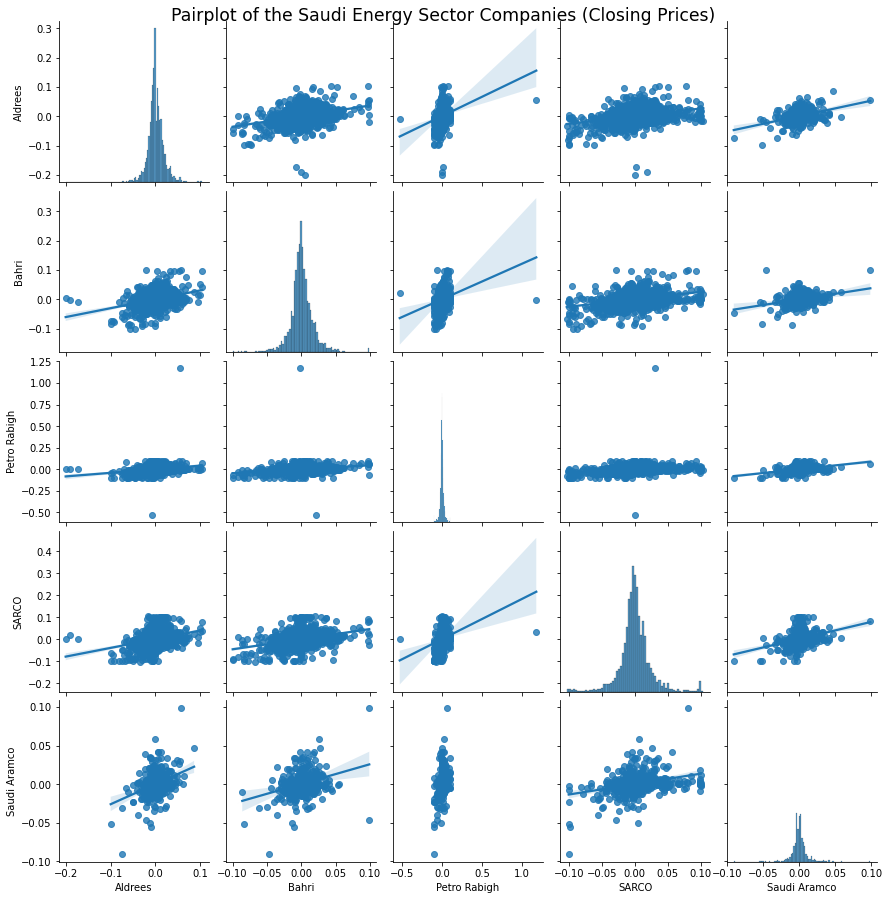

In [46]:
plt.figure(figsize=((6,6)))
pp = sns.pairplot(tech_rets, kind='reg') 
pp.fig.suptitle("Pairplot of the Saudi Energy Sector Companies (Closing Prices)",  y=1, size='xx-large') 
plt.show()
#plt.savefig('Closing Prices PairPlot', dpi=500)

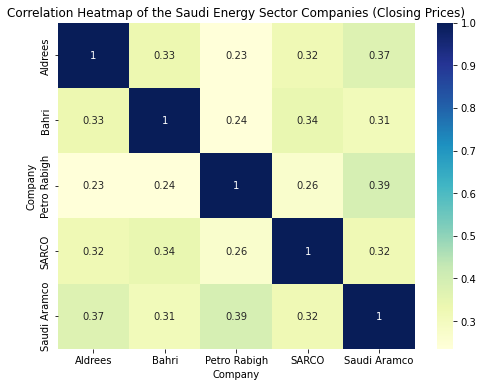

In [47]:
cormat = tech_rets.corr()
plt.figure(figsize=((8,6)));
ax = plt.axes();
sns.heatmap(cormat,annot =True,ax = ax,cmap="YlGnBu");
#ax.set_title('Correlation Heatmap of Closing Prices of the Saudi Energy Sector Companies');
plt.title('Correlation Heatmap of the Saudi Energy Sector Companies (Closing Prices)')
plt.show();


### 9. Risk vs Expected returns graph 

**How much value do we put at risk by investing in the following Saudi energy companies' stocks?**


#### Insight 
---
This graph shows the expected returns with the risk of all the companies starting from December 15, 2019. The expected return is calculated using the mean value of the percentage change of the closing price, while the risk is the standard deviation of the closing price percentage change. As can be seen, the SARCO shows the highest expected returns with 0.18%, while it has the highest risk with 2.90%. This may result from instability in this company's prices, as shown in the graph[]. On the other hand, Aramco shows the lowest risk, but the return is lower than three companies. Bahrai shows the lowest expected return, though it does not have the lowest risk. Petro Rabigh exhibits the worst scenario as the risk is very high compared to its expected returns, with about 0.09% expected returns and 2.75% risk. 

In [51]:
rets = tech_rets.dropna()
rets.head()

Company,Aldrees,Bahri,Petro Rabigh,SARCO,Saudi Aramco
Date,,,,,
2019-12-15,0.033929,0.022189,0.011211,-0.019630,0.016442
2019-12-16,0.001727,0.026049,0.018477,0.002356,0.016176
2019-12-17,-0.006897,0.043724,0.006531,-0.027027,-0.006657
2019-12-18,0.022569,0.016216,0.053353,0.013285,-0.027972
2019-12-19,0.010187,0.007979,-0.019849,0.004768,-0.032674


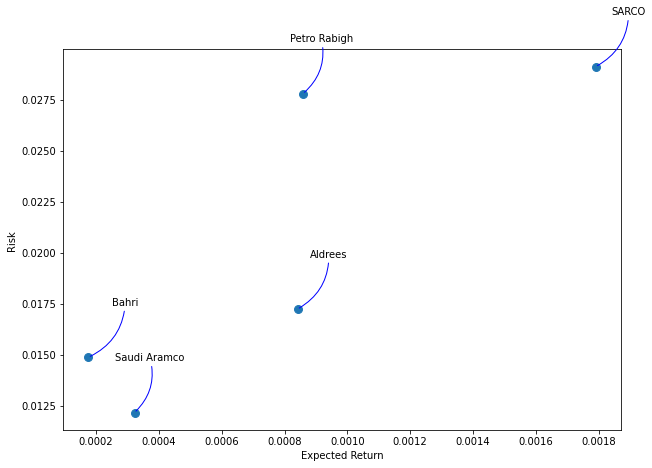

In [52]:
#The expected return is the mean value of percentage change, while the risk is the standard deviation of the percentage change
# Comparing the expected return to the daily return standard deviation
rets = tech_rets.dropna()

area = np.pi * 20

plt.figure(figsize=(10, 7))
plt.scatter(rets.mean(), rets.std(), s=area)
plt.xlabel('Expected Return')
plt.ylabel('Risk')

for label, x, y in zip(rets.columns, rets.mean(), rets.std()):
    plt.annotate(label, xy=(x, y), xytext=(50, 50), textcoords='offset points', ha='right', va='bottom', 
                 arrowprops=dict(arrowstyle='-', color='blue', connectionstyle='arc3,rad=-0.3'))
plt.savefig('risk vs expected returns',dpi =200)

###  Functions for Trading Strategy using MACD and MACD Signal

---

This methods and graphs are taking from this [Resource](https://www.kaggle.com/code/korfanakis/stock-technical-indicators-for-tesla-macd-rsi/notebook)

In [49]:

def get_MACD_Signal_and_Histogram(df):
    """Return a new DataFrame with the MACD and related information (signal line and histogram)."""
    EMA_12 = pd.Series(df['Close'].ewm(span=12, min_periods=12).mean())
    EMA_26 = pd.Series(df['Close'].ewm(span=26, min_periods=26).mean())
    df['MACD'] = pd.Series(EMA_12 - EMA_26)
    # Signal line = 9-day EMA of the MACD line.
    df['Signal'] = df['MACD'].ewm(span=9, adjust=False).mean()

    # Histogram = MACD - Indicator.
    df['Histogram'] = df['MACD'] - df['Signal']

    return df


In [50]:
def get_trading_strategy(df, column='Close'):
    """Return the Buy/Sell signal on the specified (Close)"""
    buy_list, sell_list = [], []
    flag = False

    for i in range(0, len(df)):
        if df['MACD'].iloc[i] > df['Signal'].iloc[i] and flag == False:
            buy_list.append(df[column].iloc[i])
            sell_list.append(np.nan)
            flag = True

        elif df['MACD'].iloc[i] < df['Signal'].iloc[i] and flag == True:
            buy_list.append(np.nan)
            sell_list.append(df[column].iloc[i])
            flag = False

        else:
            buy_list.append(np.nan)
            sell_list.append(np.nan)

    df['Buy'] = buy_list
    df['Sell'] = sell_list

    return df

### 10.  Companies' Stocks Market Status Over Time

**The following dashboards show different subplots that can give any stock trader overview of the stock market status of each company over the years.**

*  The first sub plot shows a candlestick which consists of the stock's OHLC values (Open - High - Low - Close) and exponential moving average of the previous nine days to show the possible price direction and short stock market trends. Along these lines, we used MACD and MACD EMA-9 to calculate the single used to show sell and buy signals.  

* The second subplot consists of a MACD line that indicates the distance between two moving averages, a signal line that identifies changes in price momentum and serves as a trigger for buy and sells signals, and a histogram that depicts the difference between the MACD and the signal line. If the MACD crosses the signal line from below, it might be interpreted as a buy indication; if it crosses the signal line from above, it could be interpreted as a sell signal [[Investopedia](https://www.investopedia.com/terms/m/macd.asp)].

* The third subplot for different simple moving averages of the closing price which were used to minimize the effects of random, short-term fluctuations on a stock's price over a specified period; hence it shows the closing price trends more clearly [[Investopedia](https://www.investopedia.com/terms/m/movingaverage.asp)].

* The fourth subplot is for the RSI, which indicates overbought and oversold conditions. It can also suggest if the stocks are poised for a trend reversal or price correction and provide cues on when to buy and sell. An RSI of 70 or greater indicates overbought conditions, while an RSI of 30 or less suggests oversold conditions [[Investopedia](https://www.investopedia.com/terms/r/rsi.asp)].

* The fifth subplot is the volume histogram, which shows the number of shares traded on a stock exchange over time. The volume can indicate the market's robustness, as rising markets with rising volumes are often seen as robust and healthy. It also indicates if the market's movements can change their direction by comparing it to the closing price, where falling prices and rising volume suggest a decline in value. In the meanwhile, if prices reach new highs (or no lows) on declining volume, this may signal a reversal [[Investopedia](https://www.investopedia.com/articles/technical/02/010702.asp)].











In [52]:
df_MACD_Signle = get_MACD_Signal_and_Histogram(df_Aramco)
df_MACD_Signle = get_MACD_Signal_and_Histogram(df_Aramco)
trading_Aramco = get_trading_strategy(df_MACD_Signle)

trading_Aramco['Hist-Color'] = np.where(trading_Aramco['Histogram'] < 0, 'red', 'green')




In [53]:
df_MACD_Signle_SARCO  = get_MACD_Signal_and_Histogram(df_SARCO)
trading_SARCO = get_trading_strategy(df_MACD_Signle_SARCO)

trading_SARCO['Hist-Color'] = np.where(trading_SARCO['Histogram'] < 0, 'red', 'green')

In [54]:


########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1, 1,1,1,1])
            

fig.add_trace(go.Candlestick(x=df_Aramco['Date'],
                            open=df_Aramco['Open'],
                            high=df_Aramco['High'],
                            low=df_Aramco['Low'],
                            close=df_Aramco['Close'],
                            name='Candlestick Chart'),
                            row =1,col=1)


fig.add_trace(go.Scatter(x=df_Aramco['Date'],
                                y=df_Aramco['Close'].ewm(9).mean(),
                                name='EMA-9',
                                line=dict(color='Orange', width=2)),row =1,col=1)




fig.add_trace(go.Scatter(x=trading_Aramco['Date'],
                            y=trading_Aramco['Buy'],
                            name='Buy Signal',
                            mode='markers',
                            marker_symbol='triangle-up',
                            marker=dict(size=9),
                            line=dict(color='#79FDF9')),row=1,col=1)

fig.add_trace(go.Scatter(x=trading_Aramco['Date'],
                            y=trading_Aramco['Sell'],
                            name='Sell Signal',
                            mode='markers',
                            marker_symbol='triangle-down',
                            marker=dict(size=9, color='lime')),row=1,col=1)



fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Price (SAR)');


### ------------- MACD Hist
fig.add_trace(go.Bar(x=trading_Aramco['Date'],
                        y=trading_Aramco['Histogram'],
                        name='Histogram',
                        marker_color=trading_Aramco['Hist-Color'],
                        showlegend=True),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Aramco['Date'],
                            y=trading_Aramco['MACD'],
                            name='MACD',
                            line=dict(color='darkorange', width=2)),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Aramco['Date'],
                            y=trading_Aramco['Signal'],
                            name='Signal',
                            line=dict(color='cyan', width=2)),
                row=2,
                col=1)
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='MACD', row=2, col=1);
#---------------
fig.add_trace(go.Scatter(x=df_Aramco['Date'],
                                y=df_Aramco['Close'],
                                name='Closing Price',
                                line=dict(color='#FFFFFF', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Aramco['Date'],
                                y=df_Aramco['Close'].rolling(window=5).mean(),
                                name='SMA-5',
                                line=dict(color='#02f5b8', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Aramco['Date'],
                            y=df_Aramco['Close'].rolling(window=10).mean(),
                            name='SMA-10',
                            line=dict(color='#FF00FA', width=2)),
                row=3,
                col=1)
fig.add_trace(go.Scatter(x=df_Aramco['Date'],
                            y=df_Aramco['Close'].rolling(window=20).mean(),
                            name='SMA-20',
                            line=dict(color='#4ff502', width=2)),
                row=3,
                col=1)

                
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Moving Average', row=3, col=1);
### -------------
fig.add_trace(go.Scatter(x=df_Aramco['Date'].iloc[30:],
                            y=RSIIndicator(df_Aramco['Close']).rsi().iloc[30:],
                            name='RSI',
                            line=dict(color='gold', width=2)),
                row=4,
                col=1)

fig.update_yaxes(title_text='RSI', row=4, col=1)

# Add one red horizontal line at 70% (overvalued) and green line at 30% (undervalued)
for y_pos, color in zip([70, 30], ['Red', 'Green']):
    fig.add_shape(x0=df_Aramco['Date'].iloc[1],
                    x1=df_Aramco['Date'].iloc[-1],
                    y0=y_pos,
                    y1=y_pos,
                    type='line',
                    line=dict(color=color, width=2),
                    row=4,
                    col=1)

# Add a text box for each line
for y_pos, text, color in zip([64, 36], ['Overvalued', 'Undervalued'], ['Red', 'Green']):
    fig.add_annotation(x=df_Aramco['Date'].iloc[int(df_Aramco['Date'].shape[0] / 10)],
                        y=y_pos,
                        text=text,
                        font=dict(size=14, color=color),
                        bordercolor=color,
                        borderwidth=1,
                        borderpad=2,
                        bgcolor='lightsteelblue',
                        opacity=0.75,
                        showarrow=False,
                        row=4,
                        col=1)

# Update the y-axis limits
ymin = 25 if RSIIndicator(df_Aramco['Close']).rsi().iloc[30:].min() > 25 else RSIIndicator(df_Aramco['Close']).rsi().iloc[30:].min() - 5
ymax = 75 if RSIIndicator(df_Aramco['Close']).rsi().iloc[30:].max() < 75 else RSIIndicator(df_Aramco['Close']).rsi().iloc[30:].max() + 5
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(range=[ymin, ymax], row=4, col=1);
# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=1000,
                  height=1000,
                  plot_bgcolor='black',
                  paper_bgcolor='black',
                  title={
                      'text': '{} - Stock Dashboard'.format('Aramco'),
                      'y': 0.99
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.13,
                              yanchor='bottom',
                              y=1.008))

# ---------------------- Volum graphs 

fig.add_trace(go.Bar(x=df_Aramco['Date'],
                        y=df_Aramco['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Volume'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Volume', row=5, col=1);



# Customize axis parameters
axis_lw, axis_color = 2, 'white'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis4=dict(linewidth=axis_lw,
            linecolor=axis_color,
            mirror=True,
            showgrid=False),
yaxis4=dict(linewidth=axis_lw,
            linecolor=axis_color,
            mirror=True,
            showgrid=False),
font=dict(color=axis_color))

fig.update_layout(xaxis5=dict(linewidth=axis_lw,
            linecolor=axis_color,
            mirror=True,
            showgrid=False),
yaxis5=dict(linewidth=axis_lw,
            linecolor=axis_color,
            mirror=True,
            showgrid=False),
font=dict(color=axis_color))

fig.show()
#py.plot(fig, filename="AramcoDashboard", auto_open = True)


In [55]:

########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1,1,1,1,1])
            

fig.add_trace(go.Candlestick(x=df_SARCO['Date'],
                            open=df_SARCO['Open'],
                            high=df_SARCO['High'],
                            low=df_SARCO['Low'],
                            close=df_SARCO['Close'],
                            name='Candlestick Chart'),
                            row =1,col=1)


fig.add_trace(go.Scatter(x=df_SARCO['Date'],
                                y=df_SARCO['Close'].ewm(9).mean(),
                                name='EMA-9',
                                line=dict(color='Orange', width=2)),row =1,col=1)




fig.add_trace(go.Scatter(x=trading_SARCO['Date'],
                            y=trading_SARCO['Buy'],
                            name='Buy Signal',
                            mode='markers',
                            marker_symbol='triangle-up',
                            marker=dict(size=8),
                            line=dict(color='#79FDF9')),row=1,col=1)

fig.add_trace(go.Scatter(x=trading_SARCO['Date'],
                            y=trading_SARCO['Sell'],
                            name='Sell Signal',
                            mode='markers',
                            marker_symbol='triangle-down',
                            marker=dict(size=8, color='lime')),row=1,col=1)



fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Price (SAR)');


### ------------- MACD Hist
fig.add_trace(go.Bar(x=trading_SARCO['Date'],
                        y=trading_SARCO['Histogram'],
                        name='Histogram',
                        marker_color=trading_SARCO['Hist-Color'],
                        showlegend=True),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_SARCO['Date'],
                            y=trading_SARCO['MACD'],
                            name='MACD',
                            line=dict(color='darkorange', width=2)),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_SARCO['Date'],
                            y=trading_SARCO['Signal'],
                            name='Signal',
                            line=dict(color='cyan', width=2)),
                row=2,
                col=1)
fig.update_xaxes(rangeslider={'visible': False});

fig.update_yaxes(title_text='MACD', row=2, col=1);


#-------------------
fig.add_trace(go.Scatter(x=df_SARCO['Date'],
                                y=df_SARCO['Close'],
                                name='Closing Price',
                                line=dict(color='#FFFFFF', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_SARCO['Date'],
                                y=df_SARCO['Close'].rolling(window=5).mean(),
                                name='SMA-5',
                                line=dict(color='#02f5b8', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_SARCO['Date'],
                            y=df_SARCO['Close'].rolling(window=10).mean(),
                            name='SMA-10',
                            line=dict(color='#FF00FA', width=2)),
                row=3,
                col=1)
fig.add_trace(go.Scatter(x=df_SARCO['Date'],
                            y=df_SARCO['Close'].rolling(window=20).mean(),
                            name='SMA-20',
                            line=dict(color='#4ff502', width=2)),
                row=3,
                col=1)

                
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Moving Average', row=3, col=1);
### -------------
fig.add_trace(go.Scatter(x=df_SARCO['Date'].iloc[30:],
                            y=RSIIndicator(df_SARCO['Close']).rsi().iloc[30:],
                            name='RSI',
                            line=dict(color='gold', width=2)),
                row=4,
                col=1)

fig.update_yaxes(title_text='RSI', row=4, col=1)

# Add one red horizontal line at 70% (overvalued) and green line at 30% (undervalued)
for y_pos, color in zip([70, 30], ['Red', 'Green']):
    fig.add_shape(x0=df_SARCO['Date'].iloc[1],
                    x1=df_SARCO['Date'].iloc[-1],
                    y0=y_pos,
                    y1=y_pos,
                    type='line',
                    line=dict(color=color, width=2),
                    row=4,
                    col=1)

# Add a text box for each line
for y_pos, text, color in zip([64, 36], ['Overvalued', 'Undervalued'], ['Red', 'Green']):
    fig.add_annotation(x=df_SARCO['Date'].iloc[int(df_SARCO['Date'].shape[0] / 10)],
                        y=y_pos,
                        text=text,
                        font=dict(size=14, color=color),
                        bordercolor=color,
                        borderwidth=1,
                        borderpad=2,
                        bgcolor='lightsteelblue',
                        opacity=0.75,
                        showarrow=False,
                        row=4,
                        col=1)

# Update the y-axis limits
ymin = 25 if RSIIndicator(df_SARCO['Close']).rsi().iloc[30:].min() > 25 else RSIIndicator(df_SARCO['Close']).rsi().iloc[30:].min() - 5
ymax = 75 if RSIIndicator(df_SARCO['Close']).rsi().iloc[30:].max() < 75 else RSIIndicator(df_SARCO['Close']).rsi().iloc[30:].max() + 5
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(range=[ymin, ymax], row=4, col=1);

# --- Volume graph 
fig.add_trace(go.Bar(x=df_SARCO['Date'],
                        y=df_SARCO['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Volume'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Volume', row=5, col=1);





# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=1000,
                  height=1000,
                  plot_bgcolor='black',
                  paper_bgcolor='black',
                  title={
                      'text': '{} - Stock Dashboard'.format('SARCO'),
                      'y': 0.98
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.05,
                              yanchor='bottom',
                              y=1.003))


# Customize axis parameters
axis_lw, axis_color = 2, 'white'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))


fig.show()
#py.plot(fig, filename="SARCODashboard", auto_open = True)


In [56]:
df_MACD_Signle_Rabigh = get_MACD_Signal_and_Histogram(df_Rabigh)
trading_Rabigh = get_trading_strategy(df_MACD_Signle_Rabigh)

trading_Rabigh['Hist-Color'] = np.where(trading_Rabigh['Histogram'] < 0, 'red', 'green')
#df_Rabigh['Close'].ewm(9).mean()
#df_Rabigh['Close'].rolling(window=5).mean(),
#y=RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:],

In [57]:

########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1, 1,1,1,1])
            

fig.add_trace(go.Candlestick(x=df_Rabigh['Date'],
                            open=df_Rabigh['Open'],
                            high=df_Rabigh['High'],
                            low=df_Rabigh['Low'],
                            close=df_Rabigh['Close'],
                            name='Candlestick Chart'),
                            row =1,col=1)


fig.add_trace(go.Scatter(x=df_Rabigh['Date'],
                                y=df_Rabigh['Close'].ewm(9).mean(),
                                name='EMA-9',
                                line=dict(color='Orange', width=2)),row =1,col=1)




fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=trading_Rabigh['Buy'],
                            name='Buy Signal',
                            mode='markers',
                            marker_symbol='triangle-up',
                            marker=dict(size=9),
                            line=dict(color='#79FDF9')),row=1,col=1)

fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=trading_Rabigh['Sell'],
                            name='Sell Signal',
                            mode='markers',
                            marker_symbol='triangle-down',
                            marker=dict(size=9, color='lime')),row=1,col=1)



fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Price (SAR)');


### ------------- MACD Hist
fig.add_trace(go.Bar(x=trading_Rabigh['Date'],
                        y=trading_Rabigh['Histogram'],
                        name='Histogram',
                        marker_color=trading_Rabigh['Hist-Color'],
                        showlegend=True),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=trading_Rabigh['MACD'],
                            name='MACD',
                            line=dict(color='darkorange', width=2)),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=trading_Rabigh['Signal'],
                            name='Signal',
                            line=dict(color='cyan', width=2)),
                row=2,
                col=1)

fig.update_yaxes(title_text='MACD', row=2, col=1)
### -------------

fig.add_trace(go.Scatter(x=df_Rabigh['Date'],
                                y=df_Rabigh['Close'],
                                name='Closing Price',
                                line=dict(color='#FFFFFF', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Rabigh['Date'],
                                y=df_Rabigh['Close'].rolling(window=5).mean(),
                                name='SMA-5',
                                line=dict(color='#02f5b8', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=df_Rabigh['Close'].rolling(window=10).mean(),
                            name='SMA-10',
                            line=dict(color='#FF00FA', width=2)),
                row=3,
                col=1)
fig.add_trace(go.Scatter(x=trading_Rabigh['Date'],
                            y=df_Rabigh['Close'].rolling(window=20).mean(),
                            name='SMA-20',
                            line=dict(color='#4ff502', width=2)),
                row=3,
                col=1)

                
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Moving Average', row=3, col=1);


# ---------
fig.add_trace(go.Scatter(x=df_Rabigh['Date'].iloc[30:],
                            y=RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:],
                            name='RSI',
                            line=dict(color='gold', width=2)),
                row=4,
                col=1)

fig.update_yaxes(title_text='RSI', row=4, col=1)

# Add one red horizontal line at 70% (overvalued) and green line at 30% (undervalued)
for y_pos, color in zip([70, 30], ['Red', 'Green']):
    fig.add_shape(x0=df_Rabigh['Date'].iloc[1],
                    x1=df_Rabigh['Date'].iloc[-1],
                    y0=y_pos,
                    y1=y_pos,
                    type='line',
                    line=dict(color=color, width=2),
                    row=4,
                    col=1)

# Add a text box for each line
for y_pos, text, color in zip([64, 36], ['Overvalued', 'Undervalued'], ['Red', 'Green']):
    fig.add_annotation(x=df_Rabigh['Date'].iloc[int(df_Rabigh['Date'].shape[0] / 10)],
                        y=y_pos,
                        text=text,
                        font=dict(size=14, color=color),
                        bordercolor=color,
                        borderwidth=1,
                        borderpad=2,
                        bgcolor='lightsteelblue',
                        opacity=0.75,
                        showarrow=False,
                        row=4,
                        col=1)

# Update the y-axis limits
ymin = 25 if RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:].min() > 25 else RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:].min() - 5
ymax = 75 if RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:].max() < 75 else RSIIndicator(df_Rabigh['Close']).rsi().iloc[30:].max() + 5
fig.update_yaxes(range=[ymin, ymax], row=4, col=1)
# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=1000,
                  height=1000,
                  plot_bgcolor='black',
                  paper_bgcolor='black',
                  title={
                      'text': '{} - Stock Dashboard'.format('Rabigh'),
                      'y': 0.98
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.05,
                              yanchor='bottom',
                              y=1.003))

# --- Volume graph 
fig.add_trace(go.Bar(x=trading_Rabigh['Date'],
                        y=trading_Rabigh['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Volume'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Volume', row=5, col=1);
# Customize axis parameters
axis_lw, axis_color = 2, 'white'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))



fig.show()
#py.plot(fig, filename="RabighDashboard", auto_open = True)


In [58]:
df_MACD_Signle_Bahri = get_MACD_Signal_and_Histogram(df_Bahri)
trading_Bahri = get_trading_strategy(df_MACD_Signle_Bahri)

trading_Bahri['Hist-Color'] = np.where(trading_Bahri['Histogram'] < 0, 'red', 'green')


#df_Bahri['Close'].ewm(9).mean()
#df_Bahri['Close'].rolling(window=5).mean(),
#y=RSIIndicator(df_Bahri['Close']).rsi().iloc[30:],

In [59]:

########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1,1,1,1,1])
            

fig.add_trace(go.Candlestick(x=df_Bahri['Date'],
                            open=df_Bahri['Open'],
                            high=df_Bahri['High'],
                            low=df_Bahri['Low'],
                            close=df_Bahri['Close'],
                            name='Candlestick Chart'),
                            row =1,col=1)


fig.add_trace(go.Scatter(x=df_Bahri['Date'],
                                y=df_Bahri['Close'].ewm(9).mean(),
                                name='EMA-9',
                                line=dict(color='Orange', width=2)),row =1,col=1)




fig.add_trace(go.Scatter(x=trading_Bahri['Date'],
                            y=trading_Bahri['Buy'],
                            name='Buy Signal',
                            mode='markers',
                            marker_symbol='triangle-up',
                            marker=dict(size=9),
                            line=dict(color='#79FDF9')),row=1,col=1)

fig.add_trace(go.Scatter(x=trading_Bahri['Date'],
                            y=trading_Bahri['Sell'],
                            name='Sell Signal',
                            mode='markers',
                            marker_symbol='triangle-down',
                            marker=dict(size=9, color='lime')),row=1,col=1)



fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Price (SAR)');


### ------------- MACD Hist
fig.add_trace(go.Bar(x=trading_Bahri['Date'],
                        y=trading_Bahri['Histogram'],
                        name='Histogram',
                        marker_color=trading_Bahri['Hist-Color'],
                        showlegend=True),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Bahri['Date'],
                            y=trading_Bahri['MACD'],
                            name='MACD',
                            line=dict(color='darkorange', width=2)),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Bahri['Date'],
                            y=trading_Bahri['Signal'],
                            name='Signal',
                            line=dict(color='cyan', width=2)),
                row=2,
                col=1)

fig.update_yaxes(title_text='MACD', row=2, col=1)
### -------------
fig.add_trace(go.Scatter(x=df_Bahri['Date'],
                                y=trading_Bahri['Close'],
                                name='Closing Price',
                                line=dict(color='#FFFFFF', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Bahri['Date'],
                                y=df_Bahri['Close'].rolling(window=5).mean(),
                                name='SMA-5',
                                line=dict(color='#02f5b8', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Bahri['Date'],
                            y=df_Bahri['Close'].rolling(window=10).mean(),
                            name='SMA-10',
                            line=dict(color='#FF00FA', width=2)),
                row=3,
                col=1)
fig.add_trace(go.Scatter(x=df_Bahri['Date'],
                            y=df_Bahri['Close'].rolling(window=20).mean(),
                            name='SMA-20',
                            line=dict(color='#4ff502', width=2)),
                row=3,
                col=1)

                
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Moving Average', row=3, col=1);



#----------------
fig.add_trace(go.Scatter(x=df_Bahri['Date'].iloc[30:],
                            y=RSIIndicator(df_Bahri['Close']).rsi().iloc[30:],
                            name='RSI',
                            line=dict(color='gold', width=2)),
                row=4,
                col=1)

fig.update_yaxes(title_text='RSI', row=4, col=1)

# Add one red horizontal line at 70% (overvalued) and green line at 30% (undervalued)
for y_pos, color in zip([70, 30], ['Red', 'Green']):
    fig.add_shape(x0=df_Bahri['Date'].iloc[1],
                    x1=df_Bahri['Date'].iloc[-1],
                    y0=y_pos,
                    y1=y_pos,
                    type='line',
                    line=dict(color=color, width=2),
                    row=4,
                    col=1)

# Add a text box for each line
for y_pos, text, color in zip([64, 36], ['Overvalued', 'Undervalued'], ['Red', 'Green']):
    fig.add_annotation(x=df_Bahri['Date'].iloc[int(df_Bahri['Date'].shape[0] / 10)],
                        y=y_pos,
                        text=text,
                        font=dict(size=14, color=color),
                        bordercolor=color,
                        borderwidth=1,
                        borderpad=2,
                        bgcolor='lightsteelblue',
                        opacity=0.75,
                        showarrow=False,
                        row=4,
                        col=1)

# Update the y-axis limits
ymin = 25 if RSIIndicator(df_Bahri['Close']).rsi().iloc[30:].min() > 25 else RSIIndicator(df_Bahri['Close']).rsi().iloc[30:].min() - 5
ymax = 75 if RSIIndicator(df_Bahri['Close']).rsi().iloc[30:].max() < 75 else RSIIndicator(df_Bahri['Close']).rsi().iloc[30:].max() + 5
fig.update_yaxes(range=[ymin, ymax], row=4, col=1)
# --- Volume graph 
fig.add_trace(go.Bar(x=df_Bahri['Date'],
                        y=df_Bahri['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Volume'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Volume', row=5, col=1);
# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=1000,
                  height=1000,
                  plot_bgcolor='black',
                  paper_bgcolor='black',
                  title={
                      'text': '{} - Stock Dashboard'.format('Bahri'),
                      'y': 0.98
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.05,
                              yanchor='bottom',
                              y=1.003))
# Customize axis parameters
axis_lw, axis_color = 2, 'white'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
                  
fig.update_layout(xaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))





fig.show()
#py.plot(fig, filename="BahriDashboard", auto_open = True)


In [62]:
#df_MACD_Signle = get_MACD_Signal_and_Histogram(df_Aldrees)
df_MACD_Signle_Aldrees = get_MACD_Signal_and_Histogram(df_Aldrees)
trading_Aldrees = get_trading_strategy(df_MACD_Signle_Aldrees)

trading_Aldrees['Hist-Color'] = np.where(trading_Aldrees['Histogram'] < 0, 'red', 'green')

#df_Aldrees['Close'].ewm(9).mean()
#df_Aldrees['Close'].rolling(window=5).mean(),
#y=RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:],

In [63]:

########## Plot the four plots ##########
#fig = go.Figure()
fig = make_subplots(rows=5,
                cols=1,
                shared_xaxes=True,
                vertical_spacing=0.002,
                row_width=[1, 1,1,1,1])
            

fig.add_trace(go.Candlestick(x=df_Aldrees['Date'],
                            open=df_Aldrees['Open'],
                            high=df_Aldrees['High'],
                            low=df_Aldrees['Low'],
                            close=df_Aldrees['Close'],
                            name='Candlestick Chart'),
                            row =1,col=1)


fig.add_trace(go.Scatter(x=df_Aldrees['Date'],
                                y=df_Aldrees['Close'].ewm(9).mean(),
                                name='EMA-9',
                                line=dict(color='Orange', width=2)),row =1,col=1)




fig.add_trace(go.Scatter(x=trading_Aldrees['Date'],
                            y=trading_Aldrees['Buy'],
                            name='Buy Signal',
                            mode='markers',
                            marker_symbol='triangle-up',
                            marker=dict(size=9),
                            line=dict(color='#79FDF9')),row=1,col=1)

fig.add_trace(go.Scatter(x=trading_Aldrees['Date'],
                            y=trading_Aldrees['Sell'],
                            name='Sell Signal',
                            mode='markers',
                            marker_symbol='triangle-down',
                            marker=dict(size=9, color='lime')),row=1,col=1)



fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Price (SAR)');


### ------------- MACD Hist
fig.add_trace(go.Bar(x=trading_Aldrees['Date'],
                        y=trading_Aldrees['Histogram'],
                        name='Histogram',
                        marker_color=trading_Aldrees['Hist-Color'],
                        showlegend=True),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Aldrees['Date'],
                            y=trading_Aldrees['MACD'],
                            name='MACD',
                            line=dict(color='darkorange', width=2)),
                row=2,
                col=1)

fig.add_trace(go.Scatter(x=trading_Aldrees['Date'],
                            y=trading_Aldrees['Signal'],
                            name='Signal',
                            line=dict(color='cyan', width=2)),
                row=2,
                col=1)

fig.update_yaxes(title_text='MACD', row=2, col=1);


#-------------------
fig.add_trace(go.Scatter(x=df_Aldrees['Date'],
                                y=trading_Aldrees['Close'],
                                name='Closing Price',
                                line=dict(color='#FFFFFF', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Aldrees['Date'],
                                y=df_Aldrees['Close'].rolling(window=5).mean(),
                                name='SMA-5',
                                line=dict(color='#02f5b8', width=2)),
                row=3,
                col=1)

fig.add_trace(go.Scatter(x=df_Aldrees['Date'],
                            y=df_Aldrees['Close'].rolling(window=10).mean(),
                            name='SMA-10',
                            line=dict(color='#FF00FA', width=2)),
                row=3,
                col=1)
fig.add_trace(go.Scatter(x=df_Aldrees['Date'],
                            y=df_Aldrees['Close'].rolling(window=20).mean(),
                            name='SMA-20',
                            line=dict(color='#4ff502', width=2)),
                row=3,
                col=1)

                
fig.update_xaxes(rangeslider={'visible': False});
fig.update_yaxes(title_text='Moving Average', row=3, col=1);
### -------------
fig.add_trace(go.Scatter(x=df_Aldrees['Date'].iloc[30:],
                            y=RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:],
                            name='RSI',
                            line=dict(color='gold', width=2)),
                row=4,
                col=1)

fig.update_yaxes(title_text='RSI', row=4, col=1)

# Add one red horizontal line at 70% (overvalued) and green line at 30% (undervalued)
for y_pos, color in zip([70, 30], ['Red', 'Green']):
    fig.add_shape(x0=df_Aldrees['Date'].iloc[1],
                    x1=df_Aldrees['Date'].iloc[-1],
                    y0=y_pos,
                    y1=y_pos,
                    type='line',
                    line=dict(color=color, width=2),
                    row=4,
                    col=1)

# Add a text box for each line
for y_pos, text, color in zip([64, 36], ['Overvalued', 'Undervalued'], ['Red', 'Green']):
    fig.add_annotation(x=df_Aldrees['Date'].iloc[int(df_Aldrees['Date'].shape[0] / 10)],
                        y=y_pos,
                        text=text,
                        font=dict(size=14, color=color),
                        bordercolor=color,
                        borderwidth=1,
                        borderpad=2,
                        bgcolor='lightsteelblue',
                        opacity=0.75,
                        showarrow=False,
                        row=4,
                        col=1)

# Update the y-axis limits
ymin = 25 if RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:].min() > 25 else RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:].min() - 5
ymax = 75 if RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:].max() < 75 else RSIIndicator(df_Aldrees['Close']).rsi().iloc[30:].max() + 5
fig.update_yaxes(range=[ymin, ymax], row=4, col=1);
# --- Volume graph 
fig.add_trace(go.Bar(x=df_Aldrees['Date'],
                        y=df_Aldrees['Volume'],
                        marker=dict(color='lightskyblue',
                                    line=dict(color='lightskyblue', width=5)),
                        showlegend=False,
                        name='Volume'),
                row=5,
                col=1)

fig.update_xaxes(title_text='Date', row=5, col=1);
fig.update_yaxes(title_text='Volume', row=5, col=1);
# customized the supblots
# Update basic layout properties (width&height, background color, title, etc.)
fig.update_layout(width=1000,
                  height=1000,
                  plot_bgcolor='#0E1117',
                  paper_bgcolor='#0E1117',
                  title={
                      'text': '{} - Stock Dashboard'.format('Aldrees'),
                      'y': 0.98
                  },
                  hovermode='x unified',
                  legend=dict(orientation='h',
                              xanchor='left',
                              x=0.05,
                              yanchor='bottom',
                              y=1.003))

# Customize axis parameters
axis_lw, axis_color = 2, 'white'
fig.update_layout(xaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis1=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis2=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis3=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))

fig.update_layout(xaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis4=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))
fig.update_layout(xaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  yaxis5=dict(linewidth=axis_lw,
                              linecolor=axis_color,
                              mirror=True,
                              showgrid=False),
                  font=dict(color=axis_color))





fig.show()
#py.plot(fig, filename="AldreesDashboard", auto_open = True)
